<a href="https://colab.research.google.com/github/sfoucher/SWOT-Canada/blob/main/Atelier_HydroQuebec_12sept2024.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![](https://img.shields.io/badge/PO.DAAC-Contribution-%20?color=grey&labelColor=blue)

> Matériel provenant du PO.DAAC Cookbook, cliquez sur [ce lien](https://github.com/podaac/tutorials/blob/master/notebooks/datasets/SWOTHR_localmachine.ipynb) pour accéder à la version GitHub du carnet.

# Exploration des données hydrologiques SWOT à partir d'une machine locale

## Accès et visualisation des ensembles de données SWOT

### Prérequis:
Environnement de calcul local, par exemple un ordinateur portable.

### Objectifs d'apprentissage:
- Accéder aux données SWOT HR archivés dans le nuage NASA Earthdata en les téléchargeant sur une machine locale.
- Visualiser les données pour une vérification rapide.

#### SWOT Level 2 KaRIn High Rate Version 2.0 Datasets:

1. **River Vector Shapefile** - SWOT_L2_HR_RIVERSP_2.0

2. **Lake Vector Shapefile** - SWOT_L2_HR_LAKESP_2.0

3. **Water Mask Pixel Cloud NetCDF** - SWOT_L2_HR_PIXC_2.0

4. **Water Mask Pixel Cloud Vector Attribute NetCDF** - SWOT_L2_HR_PIXCVec_2.0

5. **Raster NetCDF** - SWOT_L2_HR_Raster_2.0

6. **Single Look Complex Data product** - SWOT_L1B_HR_SLC_2.0

_Ce carnet a été modifié et traduit par l'équipe de l'Université de Sherbrooke et de l'Université Laval. Auteurs originaux :  Cassie Nickles, NASA PO.DAAC (Feb 2024) || Autres contributeurs : Zoe Walschots (PO.DAAC Summer Intern 2023), Catalina Taglialatela (NASA PO.DAAC), Luis Lopez (NASA NSIDC DAAC)*._

_Dernière mise à jour : 10 septembre 2024_

  

### Librairies nécessaires

In [ ]:
!pip install contextily
!pip install earthaccess
!pip install --upgrade holoviews hvplot
!pip install holoviews hvplot bokeh xarray
!pip install rioxarray
!pip install rasterio
!pip install shapely
!pip install geoviews
!pip install pyproj

#!pip install hvplot


import glob
import h5netcdf
import xarray as xr
import pandas as pd
import geopandas as gpd
import contextily as cx
import numpy as np
import matplotlib.pyplot as plt
import hvplot.xarray
import holoviews as hv
import zipfile
import earthaccess
import os
import rioxarray
from shapely.geometry import mapping
import csv
import shapefile
import geoviews as gvts
from pyproj import Proj
import logging


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.7/21.7 MB 32.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.7/56.7 kB 982.9 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.4/77.4 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.5/12.5 MB 33.9 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2024.6.1
    Uninstalling fsspec-2024.6.1:
      Successfully uninstalled fsspec-2024.6.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.6.1 requires fsspec==2024.6.1, but you have fsspec 2024.9.0 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.0/5.0 MB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.4/155.4 kB 5.0 MB/s eta 0:00:00
  Attempting unins

### Connexion à Earthdata

Un compte Earthdata est nécessaire pour accèder aux données du système Earthdata de la NASA. Si vous n'en avez pas encore, rendez-vous sur https://urs.earthdata.nasa.gov pour créer votre compte. La création du compte est gratuite et ne prend que quelques minutes. Nous utilisons `earthaccess` pour vous identifier.


In [ ]:
auth = earthaccess.login()

Enter your Earthdata Login username: victoria_litalien
Enter your Earthdata password: ··········


### Accès à un fichier


#### **1. River Vector Shapefiles**

Le lien d'accès https peut être trouvé en utilisant earthaccess data search. Cette collection est composée de fichiers Reach et Node.

Earthdata Search [(voir le tutoriel)](https://nasa-openscapes.github.io/2021-Cloud-Workshop-AGU/tutorials/01_Earthdata_Search.html) peut également être utilisé pour effectuer une recherche manuelle à partir d'une interface graphique.

Pour des conseils supplémentaires concernant la recherche spatiale des données SWOT HR L2, voir également [PO.DAAC Cookbook - SWOT Chapter tips section](https://podaac.github.io/tutorials/quarto_text/SWOT.html#tips-for-swot-hr-spatial-search).



#### Recherche des données d'intérêt

In [ ]:
#Recupération des granules ayant les caractéristiques voulues en passant par la fonction `earthdata.search_data`
river_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_RIVERSP_2.0',
                                        #temporal = ('2024-02-01 00:00:00', '2024-02-29 23:59:59'), # peut également être filtré en fonction de la plage temporelle
                                        granule_name = '*Node*_576_NA*') # ici nous filtrons par fichiers Nodes (pas Reach), par passe et par continent
                                                                         # spécifier 'Node' ou 'Reach' selon le fichier voulu

In [ ]:
#Imprimer les caractéristiques des granules associés à la passe sélectionnée.
print(river_results)

[Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_RiverSP_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'BoundingRectangles': [{'WestBoundingCoordinate': -78.6797459563162, 'SouthBoundingCoordinate': 41.25931493829667, 'EastBoundingCoordinate': -70.57796565160254, 'NorthBoundingCoordinate': 55.65790751998025}]}, 'Track': {'Cycle': 2, 'Passes': [{'Pass': 576, 'Tiles': ['48L', '49L', '50L', '51L', '52L', '53L', '54L', '55L', '56L', '57L', '58L', '59L', '60L', '61L', '62L', '63L', '64L', '65L', '66L', '67L', '68L', '69L', '70L', '71L', '72L', '73L', '74L', '75L', '76L', '77L', '78L', '79L', '80L', '81L', '82L', '83L', '84L', '85L', '86L', '87L', '88L', '89L', '90L', '91L', '92L', '93L', '94L', '95L', '96L', '97L', '98L', '99L', '100L', '101L', '102L', '103L', '104L', '105L', '106L', '107L', '108L', '109L', '110L', '111L', '112L', '113L', '114L', '115L', '116L', '117L', '118L', '119L', '120L', '121L', '122L', '123L', '48R', '49R', '50R', '51R', '52R', '53R', '54R

#### Téléchargez, décompressez et lisez les données

Télédéchargeons le fichier de données sélectionné ! `earthaccess.download` a une liste comme format d'entrée, nous devons donc mettre des crochets autour du fichier que nous voulons.



In [ ]:
earthaccess.download([river_results[3]], "./data_downloads")

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

['data_downloads/SWOT_L2_HR_RiverSP_Reach_005_576_NA_20231102T054530_20231102T054541_PGC0_01.zip']

Le format natif de ces données est un fichier .zip et nous voulons le fichier .shp dans ce fichier .zip. Nous devons donc extraire les données pour les ouvrir. Nous allons récupérer le nom du fichier que nous venons de télécharger, puis extraire toutes les données dans le dossier `data_downloads`.

In [ ]:
filename = earthaccess.results.DataGranule.data_links(river_results[3], access='external')
filename = filename[0].split("/")[-1]
filename

'SWOT_L2_HR_RiverSP_Reach_005_576_NA_20231102T054530_20231102T054541_PGC0_01.zip'

In [ ]:
with zipfile.ZipFile(f'data_downloads/{filename}', 'r') as zip_ref:
    zip_ref.extractall('data_downloads')

Ouverture du fichier shapefile avec `geopandas`

In [ ]:
filename_shp = filename.replace('.zip','.shp')

In [ ]:
SWOT_HR_shp1 = gpd.read_file(f'data_downloads/{filename_shp}')

#afficher la table d'attributs
SWOT_HR_shp1

,reach_id,node_id,time,time_tai,time_str,lat,lon,lat_u,lon_u,river_name,...,p_wse,p_wse_var,p_width,p_wid_var,p_dist_out,p_length,p_dam_id,p_n_ch_max,p_n_ch_mod,geometry
0,72120400171,72120400170011,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,no_data,...,308.5,0.000000,127.0,77.440,435212.0,212.132041,0,1,1,POINT (-75.68324 49.74893)
1,72120400171,72120400170021,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,no_data,...,308.5,0.000000,127.0,0.000,435408.0,196.101394,0,1,1,POINT (-75.68127 49.75029)
2,72120400171,72120400170031,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,no_data,...,308.5,0.000000,138.0,105.840,435589.0,180.730791,0,1,1,POINT (-75.67956 49.75169)
3,72120400171,72120400170041,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,no_data,...,308.5,0.000347,123.0,247.250,435793.0,203.597704,0,1,1,POINT (-75.67805 49.75291)
4,72120400171,72120400170051,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,no_data,...,308.6,0.000000,80.0,149.959,436013.0,220.432202,0,1,1,POINT (-75.67539 49.75385)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25265,76500000131,76500000130611,7.522198e+08,7.522198e+08,2023-11-02T05:56:28Z,1.821631e+01,-6.600156e+01,2.976825e-04,-1.000000e+12,no_data,...,59.3,0.000000,30.0,148.776,43590.0,210.595303,0,1,1,POINT (-66.00107 18.21744)
25266,76500000141,76500000140011,7.522198e+08,7.522198e+08,2023-11-02T05:56:28Z,-1.000000e+12,-1.000000e+12,-1.000000e+12,-1.000000e+12,no_data,...,63.1,0.000000,30.0,27.918,43800.0,196.172066,0,1,1,POINT (-65.99946 18.21662)
25267,76500000141,76500000140021,7.522198e+08,7.522198e+08,2023-11-02T05:56:28Z,1.821542e+01,-6.600088e+01,3.796086e-04,-1.000000e+12,no_data,...,63.1,0.000000,36.0,80.816,43978.0,212.970843,0,1,1,POINT (-65.99938 18.21473)
25268,76500000141,76500000140031,7.522198e+08,7.522198e+08,2023-11-02T05:56:28Z,1.821436e+01,-6.600196e+01,8.335472e-05,-1.000000e+12,no_data,...,63.1,18.007497,46.0,722.188,44191.0,178.614996,0,1,1,POINT (-65.99978 18.21317)


#### Affichage des données des rivières SWOT

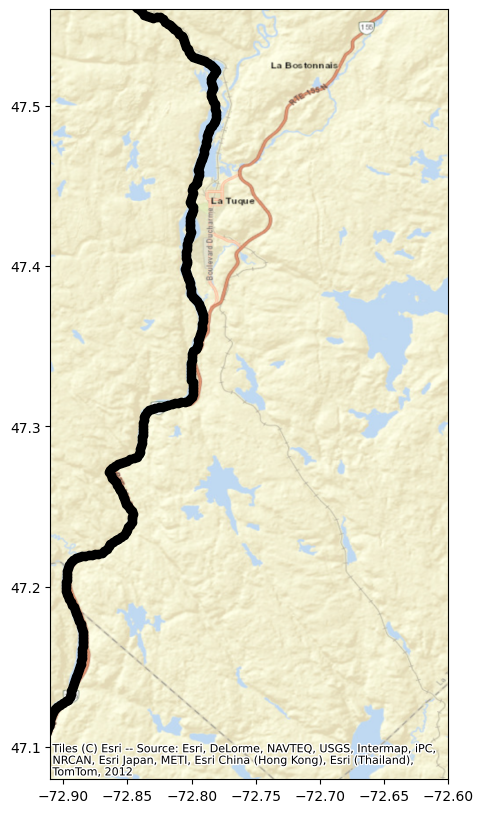

In [ ]:
# Affichage simple
fig, ax = plt.subplots(figsize=(10,10))
SWOT_HR_shp1.plot(ax=ax, color='black')
ax.set_ylim(47.08,47.56) #sélectionnez votre zone d'intérêt pour un meilleur apeçu
ax.set_xlim(-72.91,-72.60) #sélectionnez votre zone d'intérêt pour un meilleur apeçu
cx.add_basemap(ax, crs=SWOT_HR_shp1.crs, source=cx.providers.Esri.WorldStreetMap)

In [ ]:
# Il est également possible d'afficher les données avec la fonction `explore` de geopandas
#SWOT_HR_shp1.explore()

#### **2. Lake Vector Shapefiles**

Les fichiers vectoriels des lacs sont accessibles de la même manière que les fichiers vectoriels des rivières ci-dessus.

Pour des conseils supplémentaires sur la recherche spatiale des données SWOT HR L2, voir également [PO.DAAC Cookbook - SWOT Chapter tips section](https://podaac.github.io/tutorials/quarto_text/SWOT.html#tips-for-swot-hr-spatial-search).

#### Recherche des données d'intérêt

In [ ]:
lake_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_LAKESP_2.0',
                                        #temporal = ('2024-02-01 00:00:00', '2024-02-29 23:59:59'), # peut également être filtré en fonction de la plage temporelle
                                        granule_name = '*Prior*_576_NA*') # ici nous filtrons les fichiers avec 'Prior' (Cette collection a trois options : Obs, Unassigned, et Prior), par passe et par continent

In [ ]:
#Imprimer les caractéristiques des granules associés à la passe sélectionnée.
print(lake_results)

[Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_LakeSP_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'BoundingRectangles': [{'WestBoundingCoordinate': -78.6797459563162, 'SouthBoundingCoordinate': 41.25931493829667, 'EastBoundingCoordinate': -70.57796565160254, 'NorthBoundingCoordinate': 55.65790751998025}]}, 'Track': {'Cycle': 2, 'Passes': [{'Pass': 576, 'Tiles': ['56R', '57R', '58R', '59R', '60R', '61R', '62R', '63R', '64R', '65R', '66R', '67R', '68R', '69R', '70R', '71R', '72R', '73R', '74R', '75R', '76R', '77R', '78R', '79R', '80R', '81R', '82R', '56L', '57L', '58L', '59L', '60L', '61L', '62L', '63L', '64L', '65L', '66L', '67L', '68L', '69L', '70L', '71L', '72L', '73L', '74L', '75L', '76L', '77L', '78L', '79L', '80L', '81L', '82L']}]}}}
Temporal coverage: {'RangeDateTime': {'EndingDateTime': '2023-08-31T15:34:30.737Z', 'BeginningDateTime': '2023-08-31T15:30:16.059Z'}}
Size(MB): 76.04944324493408
Data: ['https://archive.swot.podaac.earthdata.nasa.gov/pod

Téléchargez le fichier de données sélectionné ! earthaccess.download a une liste comme format d'entrée, nous devons donc mettre des crochets autour du fichier que nous voulons.

In [ ]:
earthaccess.download([lake_results[0]], "./data_downloads")

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

['data_downloads/SWOT_L2_HR_LakeSP_Prior_002_576_NA_20230831T153016_20230831T153430_PGC0_01.zip']

Le format natif de ces données est un fichier .zip et nous voulons le fichier .shp dans ce fichier .zip. Nous devons donc extraire les données pour les ouvrir. Nous allons récupérer le nom du fichier que nous venons de télécharger, puis extraire toutes les données dans le dossier `data_downloads`.

In [ ]:
filename2 = earthaccess.results.DataGranule.data_links(lake_results[0], access='external')
filename2 = filename2[0].split("/")[-1]
filename2

'SWOT_L2_HR_LakeSP_Prior_002_576_NA_20230831T153016_20230831T153430_PGC0_01.zip'

In [ ]:
with zipfile.ZipFile(f'data_downloads/{filename2}', 'r') as zip_ref:
    zip_ref.extractall('data_downloads')

Ouverture du shapefile avec `geopandas`

In [ ]:
filename_shp2 = filename2.replace('.zip','.shp')
filename_shp2

'SWOT_L2_HR_LakeSP_Prior_002_576_NA_20230831T153016_20230831T153430_PGC0_01.shp'

In [ ]:
SWOT_HR_shp2 = gpd.read_file(f'data_downloads/{filename_shp2}')

#Afficher la table d'attributs
SWOT_HR_shp2

,lake_id,reach_id,obs_id,overlap,n_overlap,time,time_tai,time_str,wse,wse_u,...,lake_name,p_res_id,p_lon,p_lat,p_ref_wse,p_ref_area,p_date_t0,p_ds_t0,p_storage,geometry
0,7210135482,no_data,no_data,no_data,no_data,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,...,no_data,-99999999,-74.317938,49.158840,-1.000000e+12,0.021600,no_data,-1.000000e+12,-1.000000e+12,None
1,7210135812,no_data,no_data,no_data,no_data,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,...,no_data,-99999999,-74.281742,49.161429,-1.000000e+12,0.070200,no_data,-1.000000e+12,-1.000000e+12,None
2,7210136122,no_data,no_data,no_data,no_data,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,...,no_data,-99999999,-74.319970,49.196272,-1.000000e+12,0.109800,no_data,-1.000000e+12,-1.000000e+12,None
3,7210136212,no_data,no_data,no_data,no_data,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,...,no_data,-99999999,-74.286318,49.158550,-1.000000e+12,0.061201,no_data,-1.000000e+12,-1.000000e+12,None
4,7210136352,no_data,no_data,no_data,no_data,-1.000000e+12,-1.000000e+12,no_data,-1.000000e+12,-1.000000e+12,...,no_data,-99999999,-74.262539,49.201087,-1.000000e+12,0.507600,no_data,-1.000000e+12,-1.000000e+12,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61803,7210156512,no_data,721065R099978;721066R000015,98;0,2,7.468111e+08,7.468111e+08,2023-08-31T15:31:47Z,3.587920e+02,1.000000e-03,...,ASSINICA;LAC VAPOSITE;LAC ASSINICA;LAC COMENCHO,-99999999,-75.209886,50.439682,-1.000000e+12,161.636420,no_data,-1.000000e+12,-1.000000e+12,"MULTIPOLYGON (((-75.23719 50.42063, -75.23726 ..."
61804,7210232722,no_data,721060R099966;721060R000455;721060R000433,85;1;1,3,7.468111e+08,7.468111e+08,2023-08-31T15:30:53Z,1.849880e+02,5.000000e-03,...,no_data,-99999999,-77.154423,53.292141,-1.000000e+12,6.848100,no_data,-1.000000e+12,-1.000000e+12,"MULTIPOLYGON (((-77.14282 53.29309, -77.14292 ..."
61805,7250179013,72530600183;72530600193;72530600333;7253060052...,725075R000358;725076R099947;725076R099963;7250...,25;3;3;1;0;0;0;0;0,9,7.468112e+08,7.468112e+08,2023-08-31T15:33:26Z,2.873100e+01,8.000000e-03,...,BASSIN DE CHAMBLY;CHAMPLAIN;THE MARSH;SAND BAR...,-99999999,-73.305005,44.620947,-1.000000e+12,1149.778158,no_data,-1.000000e+12,-1.000000e+12,"MULTIPOLYGON (((-73.24805 45.20279, -73.24812 ..."
61806,7250966123,72520900051;72520900066,725069R000001;725068R099943;725069R099953;7250...,39;18;0;0;0;0;0;0;0;0;0;0;0,13,7.468111e+08,7.468112e+08,2023-08-31T15:32:20Z,4.044650e+02,8.000000e-03,...,RSERVOIR GOUIN;GOUIN RESERVOIR;LAC SAVERNEY;GO...,2023,-74.811603,48.539692,-1.000000e+12,1318.061046,no_data,-1.000000e+12,-1.000000e+12,"MULTIPOLYGON (((-74.89492 48.57413, -74.89500 ..."


#### Affichage des données des lacs SWOT

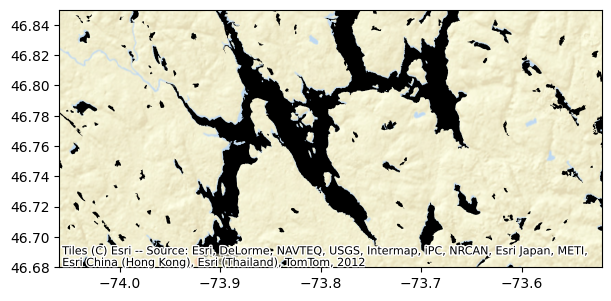

In [ ]:
fig, ax = plt.subplots(figsize=(7,7))
SWOT_HR_shp2.plot(ax=ax, color='black')
ax.set_ylim(46.68,46.85) #sélectionnez votre zone d'intérêt pour un meilleur apeçu  (Exemple : lac Taureau)
ax.set_xlim(-74.06,-73.52) #sélectionnez votre zone d'intérêt pour un meilleur apeçu
cx.add_basemap(ax, crs=SWOT_HR_shp2.crs, source=cx.providers.Esri.WorldStreetMap)


L'accès aux fichiers ci-dessous est différent de celui des fichiers .shp présentés jusqu'à maintenant. Puisque les collections SWOT HR suivantes sont stockées sous forme de fichiers **netCDF** dans le nuage, nous n'avons pas besoin d'extraire les shapefiles d'un fichier zip. Pour le reste des produits, nous les ouvrirons via `xarray` et non `geopandas`.

#### **3. Water Mask Pixel Cloud NetCDF**

#### Recherche des données de la collection selon les caractéristiques voulues

In [ ]:
pixc_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_PIXC_2.0',
                                        #temporal = ('2024-02-01 00:00:00', '2024-02-29 23:59:59'), # filtre en fonction de la plage temporelle
                                        granule_name = '*_576_073L*') # numéro de pass, de tuile et côté de fauchée (R ou L)
                                        #bounding_box = (-72.73,46.58,-72.60,46.62)) # filtre par boîte englobante, pour trouver votre boîte englobante : http://bboxfinder.com/

In [ ]:
#Imprimer les caractéristiques des granules associés à la passe, à la tuile et à la fauchée.
print(pixc_results)

[Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_PIXC_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'BoundingRectangles': [{'WestBoundingCoordinate': -73.21121876856989, 'SouthBoundingCoordinate': 45.96880338497641, 'EastBoundingCoordinate': -72.10944100466918, 'NorthBoundingCoordinate': 46.74221902356065}]}, 'Track': {'Cycle': 2, 'Passes': [{'Pass': 576, 'Tiles': ['073L']}]}}}
Temporal coverage: {'RangeDateTime': {'EndingDateTime': '2023-08-31T15:33:08.914Z', 'BeginningDateTime': '2023-08-31T15:32:57.816Z'}}
Size(MB): 547.8803548812866
Data: ['https://archive.swot.podaac.earthdata.nasa.gov/podaac-swot-ops-cumulus-protected/SWOT_L2_HR_PIXC_2.0/SWOT_L2_HR_PIXC_002_576_073L_20230831T153257_20230831T153308_PGC0_01.nc'], Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_PIXC_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'BoundingRectangles': [{'WestBoundingCoordinate': -73.2111659108291, 'SouthBoundingCoordinate': 45.96878184584341, 'Ea

Téléchargez le fichier de données sélectionné ! earthaccess.download a une liste comme format d'entrée, nous devons donc mettre des crochets autour du fichier que nous voulons.

In [ ]:
earthaccess.download([pixc_results[1]], "./data_downloads")

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

['data_downloads/SWOT_L2_HR_PIXC_003_576_073L_20230921T121803_20230921T121814_PGC0_01.nc']

#### Ourvrir les données avec xarray





Ces fichiers netCDF sont formatés en trois groupes intitulés "pixel cloud", "tvp", ou "noise" (plus de détails [ici](https://podaac-tools.jpl.nasa.gov/drive/files/misc/web/misc/swot_mission_docs/pdd/D-56411_SWOT_Product_Description_L2_HR_PIXC_20200810.pdf)). Afin d'accéder aux coordonnées et aux variables du fichier, un groupe doit être spécifié lors de l'appel à xarray open_dataset.

In [ ]:
ds_PIXC = xr.open_mfdataset("data_downloads/SWOT_L2_HR_PIXC_*.nc", group = 'pixel_cloud', engine='h5netcdf') #Si plusieurs fichiers PIXC sont téléchargés dans le fichier data_download, spécifiez lequel des fichiers doit être affiché.
ds_PIXC


<xarray.Dataset> Size: 1GB
Dimensions:                                (points: 5299061, complex_depth: 2,
                                            num_pixc_lines: 3265)
Coordinates:
    latitude                               (points) float64 42MB dask.array<chunksize=(481733,), meta=np.ndarray>
    longitude                              (points) float64 42MB dask.array<chunksize=(481733,), meta=np.ndarray>
Dimensions without coordinates: points, complex_depth, num_pixc_lines
Data variables: (12/61)
    azimuth_index                          (points) float64 42MB dask.array<chunksize=(883177,), meta=np.ndarray>
    range_index                            (points) float64 42MB dask.array<chunksize=(883177,), meta=np.ndarray>
    interferogram                          (points, complex_depth) float32 42MB dask.array<chunksize=(1324766, 1), meta=np.ndarray>
    power_plus_y                           (points) float32 21MB dask.array<chunksize=(883177,), meta=np.ndarray>
    power_minus_y                          (points) float32 21MB dask.array<chunksize=(883177,), meta=np.ndarray>
    coherent_power                         (points) float32 21MB dask.array<chunksize=(883177,), meta=np.ndarray>
    ...                                     ...
    pixc_line_qual                         (num_pixc_lines) float64 26kB dask.array<chunksize=(3265,), meta=np.ndarray>
    pixc_line_to_tvp                       (num_pixc_lines) float32 13kB dask.array<chunksize=(3265,), meta=np.ndarray>
    data_window_first_valid                (num_pixc_lines) float64 26kB dask.array<chunksize=(3265,), meta=np.ndarray>
    data_window_last_valid                 (num_pixc_lines) float64 26kB dask.array<chunksize=(3265,), meta=np.ndarray>
    data_window_first_cross_track          (num_pixc_lines) float32 13kB dask.array<chunksize=(3265,), meta=np.ndarray>
    data_window_last_cross_track           (num_pixc_lines) float32 13kB dask.array<chunksize=(3265,), meta=np.ndarray>
Attributes:
    description:                 cloud of geolocated interferogram pixels
    interferogram_size_azimuth:  3265
    interferogram_size_range:    4728
    looks_to_efflooks:           1.543933250729491
    num_azimuth_looks:           7.0
    azimuth_offset:              4

#### Affichage des données

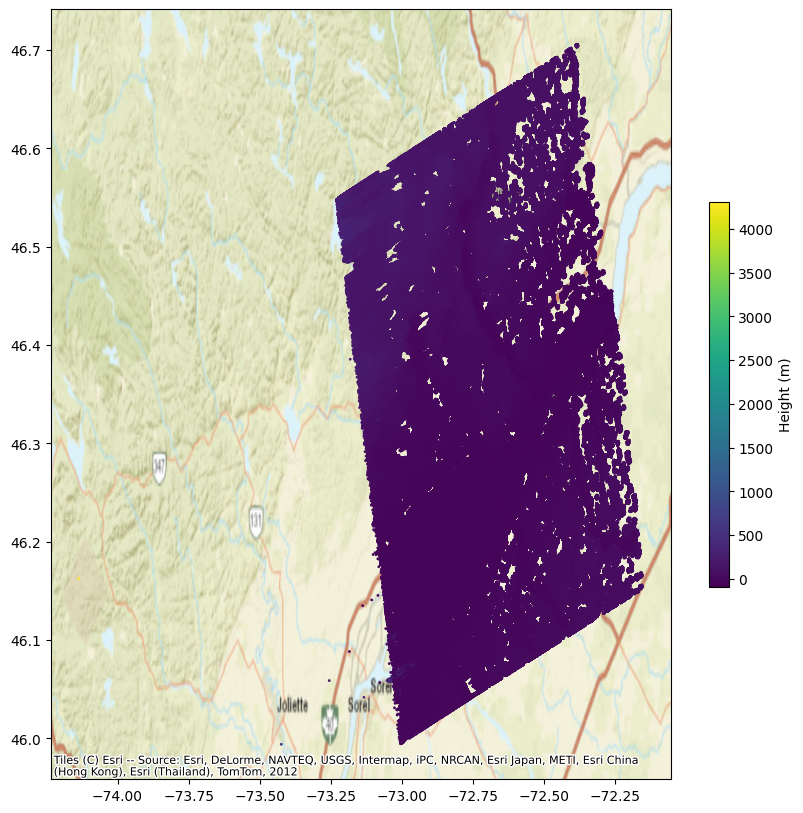

In [ ]:
# L'affichage peut prendre quelques minutes (environ 5 minutes)
fig, ax = plt.subplots(figsize=(10, 10))
cax=plt.scatter(x=ds_PIXC.longitude, y=ds_PIXC.latitude, c=ds_PIXC.height, s=1) #ajustement de la taille des pixels avec s= taille désirée
cbar = fig.colorbar(cax, ax=ax, shrink=0.5)
cbar.set_label('Height (m)')

# ajustement de la barre de couleur
cbar.ax.set_aspect('auto')

cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.Esri.WorldStreetMap)




#### Coupez et convertissez le PIXC en un fichier .shp pour permettre son ouverture dans QGIS.

In [ ]:
from shapely.geometry import Point, Polygon


logging.getLogger('fiona').setLevel(logging.ERROR)

lat_min = 46.58
lat_max = 46.62
lon_min = -72.73
lon_max = -72.60

lat = np.asarray(ds_PIXC.latitude[:])
lon = np.asarray(ds_PIXC.longitude[:])
classif  = np.asarray(ds_PIXC.classification[:])

mask = (lat > lat_min) & (lat < lat_max) & (lon > lon_min) & (lon < lon_max) & (classif>2) & (classif<5)
#mask = (lat > lat_min) & (lat < lat_max) & (lon > lon_min) & (lon < lon_max)

data = {}
exclude_vars = ['interferogram', 'illumination_time','illumination_time_tai','pixc_line_qual', 'pixc_line_to_tvp','data_window_first_valid','data_window_last_valid','data_window_first_cross_track','data_window_last_cross_track']
for var_name in ds_PIXC.variables:
    if var_name not in exclude_vars:
        var_data = np.asarray(ds_PIXC.variables[var_name][:])
        var_data = var_data[mask]
        if len(var_data.shape) > 1:
            var_data = var_data.reshape(-1)
        data[var_name] = var_data

df = pd.DataFrame(data)

points = [Point(x, y) for x, y in zip(df.longitude, df.latitude)]

gdf_out = gpd.GeoDataFrame(df, geometry=points, crs="EPSG:4326")
out_shp= './data_downloads/SWOT_L2_HR_PIXC_003_576_073L_20230921T121803_20230921T121814_PGC0_01.shp'
gdf_out.to_file(out_shp)


<ipython-input-53-6c80c870fdaf>:34: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  gdf_out.to_file(out_shp)


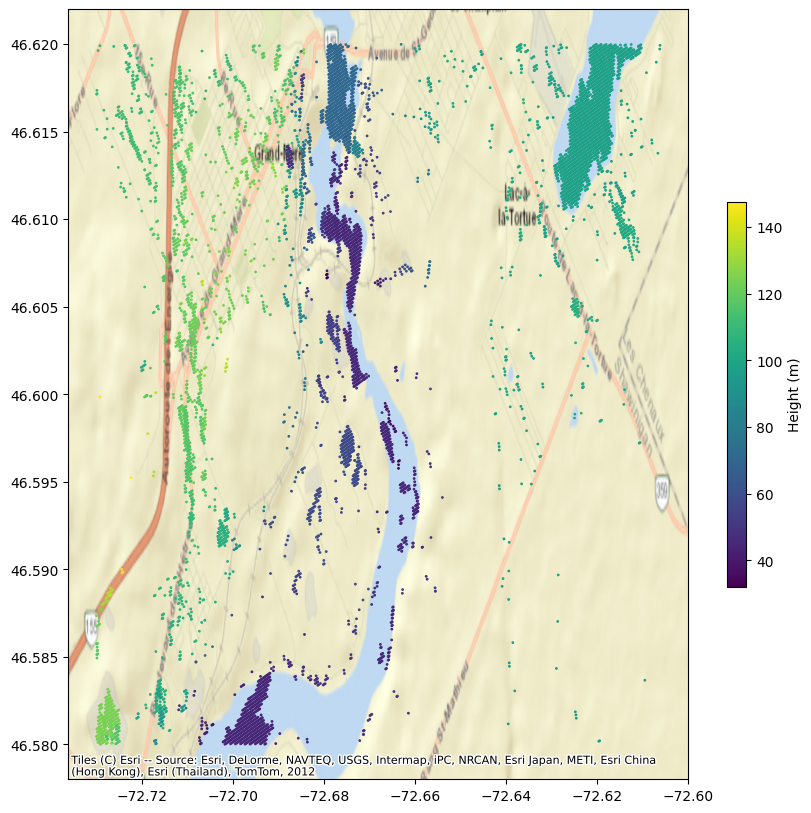

In [ ]:
# Affichez vos données PIXC coupées. Vous pouvez aussi les télécharger pour les visualiser dans QGIS.
fig, ax = plt.subplots(figsize=(10, 10))
cax= plt.scatter(x=gdf_out.longitude, y=gdf_out.latitude, c=gdf_out.height, s=1) #ajustement de la taille des pixels avec s= taille désirée
cbar = fig.colorbar(cax, ax=ax, shrink=0.5)
cbar.set_label('Height (m)')

# ajustement de la barre de couleur
cbar.ax.set_aspect('auto')

cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.Esri.WorldStreetMap)



#### **4. Water Mask Pixel Cloud Vector Attribute NetCDF**

#### Recherche des données d'intérêt

In [ ]:
pixcvec_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_PIXCVEC_2.0',
                                        #temporal = ('2024-02-01 00:00:00', '2024-02-29 23:59:59'), # peut également être filtré en fonction de la plage horaire
                                        granule_name = '*_576_073L*') # numéro de pass, de tuile et côté de fauchée (R ou L)
                                        #bounding_box = (-72.73,46.58,-72.60,46.62)) # filtre par boîte englobante, pour trouver votre boîte englobante : http://bboxfinder.com/


In [ ]:
#Imprimer les caractéristiques des granules
print(pixcvec_results)

[Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_PIXCVec_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'BoundingRectangles': [{'WestBoundingCoordinate': -73.21121876856989, 'SouthBoundingCoordinate': 45.96880338497641, 'EastBoundingCoordinate': -72.10944100466918, 'NorthBoundingCoordinate': 46.74221902356065}]}, 'Track': {'Cycle': 2, 'Passes': [{'Pass': 576, 'Tiles': ['73L']}]}}}
Temporal coverage: {'RangeDateTime': {'EndingDateTime': '2023-08-31T15:33:08.914Z', 'BeginningDateTime': '2023-08-31T15:32:57.816Z'}}
Size(MB): 16.68362045288086
Data: ['https://archive.swot.podaac.earthdata.nasa.gov/podaac-swot-ops-cumulus-protected/SWOT_L2_HR_PIXCVec_2.0/SWOT_L2_HR_PIXCVec_002_576_073L_20230831T153257_20230831T153308_PGC0_02.nc'], Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_PIXCVec_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'BoundingRectangles': [{'WestBoundingCoordinate': -73.2111659108291, 'SouthBoundingCoordinate': 45.96878184

Téléchargez le fichier de données sélectionné ! earthaccess.download a une liste comme format d'entrée, nous devons donc mettre des crochets autour du fichier que nous voulons.

In [ ]:
earthaccess.download([pixcvec_results[0]], "./data_downloads")

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

['data_downloads/SWOT_L2_HR_PIXCVec_002_576_073L_20230831T153257_20230831T153308_PGC0_02.nc']

#### Ouverture des données avec xarray

Nous allons chercher automatiquement le nom du fichier que nous venons de télécharger, puis nous allons l'afficher avec `xarray`.

In [ ]:
ds_PIXCVEC = xr.open_mfdataset("data_downloads/SWOT_L2_HR_PIXCVec_*.nc", decode_cf=False,  engine='h5netcdf')
ds_PIXCVEC

<xarray.Dataset> Size: 456MB
Dimensions:               (points: 5842786, nchar_reach_id: 11,
                           nchar_node_id: 14, nchar_lake_id: 10,
                           nchar_obs_id: 13)
Dimensions without coordinates: points, nchar_reach_id, nchar_node_id,
                                nchar_lake_id, nchar_obs_id
Data variables:
    azimuth_index         (points) int32 23MB dask.array<chunksize=(973798,), meta=np.ndarray>
    range_index           (points) int32 23MB dask.array<chunksize=(973798,), meta=np.ndarray>
    latitude_vectorproc   (points) float64 47MB dask.array<chunksize=(486899,), meta=np.ndarray>
    longitude_vectorproc  (points) float64 47MB dask.array<chunksize=(486899,), meta=np.ndarray>
    height_vectorproc     (points) float32 23MB dask.array<chunksize=(973798,), meta=np.ndarray>
    reach_id              (points, nchar_reach_id) |S1 64MB dask.array<chunksize=(1460697, 2), meta=np.ndarray>
    node_id               (points, nchar_node_id) |S1 82MB dask.array<chunksize=(1168558, 2), meta=np.ndarray>
    lake_id               (points, nchar_lake_id) |S1 58MB dask.array<chunksize=(1460697, 2), meta=np.ndarray>
    obs_id                (points, nchar_obs_id) |S1 76MB dask.array<chunksize=(1168558, 2), meta=np.ndarray>
    ice_clim_f            (points) int8 6MB dask.array<chunksize=(2921393,), meta=np.ndarray>
    ice_dyn_f             (points) int8 6MB dask.array<chunksize=(2921393,), meta=np.ndarray>
Attributes: (12/45)
    Conventions:                     CF-1.7
    title:                           Level 2 KaRIn high rate pixel cloud vect...
    short_name:                      L2_HR_PIXCVec
    institution:                     JPL
    source:                          Level 1B KaRIn High Rate Single Look Com...
    history:                         2024-06-10T19:20:09.248945Z: Creation
    ...                              ...
    xref_prior_river_db_file:        
    xref_prior_lake_db_file:         SWOT_LakeDatabase_Nom_576_20000101T00000...
    xref_reforbittrack_files:        SWOT_RefOrbitTrackTileBoundary_Nom_20000...
    xref_param_l2_hr_laketile_file:  SWOT_Param_L2_HR_LakeTile_20000101T00000...
    ellipsoid_semi_major_axis:       6378137.0
    ellipsoid_flattening:            0.0033528106647474805

#### Affichage rapide

In [ ]:
pixcvec_htvals = ds_PIXCVEC.height_vectorproc.compute()
pixcvec_latvals = ds_PIXCVEC.latitude_vectorproc.compute()
pixcvec_lonvals = ds_PIXCVEC.longitude_vectorproc.compute()

#Avant d'afficher le graphique, les valeurs de remplissage sont fixées à NaN (Not a Number) afin d'améliorer l'affichage du graphique dans l'espace.
pixcvec_htvals[pixcvec_htvals > 15000] = np.nan
pixcvec_latvals[pixcvec_latvals < 1] = np.nan
pixcvec_lonvals[pixcvec_lonvals > -1] = np.nan


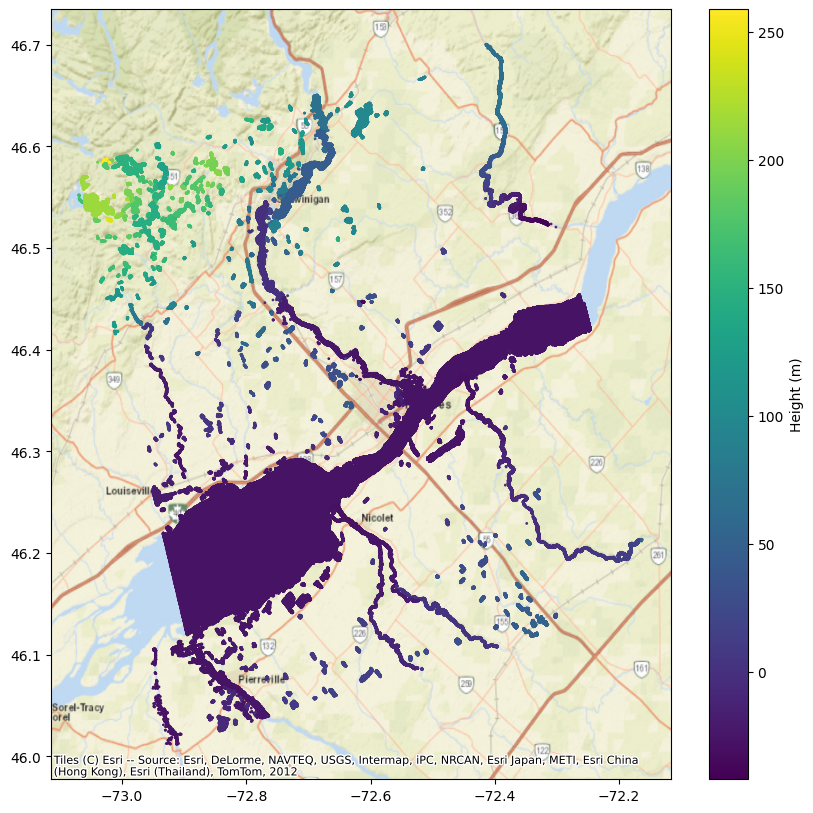

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
plt.scatter(x=pixcvec_lonvals, y=pixcvec_latvals, c=pixcvec_htvals, s=1) #ajustement de la taille des pixels avec s= taille désirée
plt.colorbar().set_label('Height (m)')

cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.Esri.WorldStreetMap)
plt.show()

#### **5. Raster NetCDF**

#### Recherche des données d'intérêt

In [ ]:
raster_results = earthaccess.search_data(short_name = 'SWOT_L2_HR_Raster_2.0',
                                        #temporal = ('2024-02-01 00:00:00', '2024-02-29 23:59:59'), # peut également être filtré en fonction de la plage temporelle
                                        #bounding_box = (-72.73,46.58,-72.60,46.62), # filtre par boîte englobante, pour trouver votre boîte englobante : http://bboxfinder.com/
                                        granule_name = '*100m*_576_037F*') # ici nous filtrons les données avec la mention '100m' (Cette collection à deux options de résolution: 100m & 250m)



In [ ]:
#Imprimer les caractéristiques des granules associées à la passe, à la scène et à la résolution sélectionnées.
print(raster_results)

[Collection: {'Version': '2.0', 'ShortName': 'SWOT_L2_HR_Raster_2.0'}
Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'GPolygons': [{'Boundary': {'Points': [{'Latitude': 45.28823771155892, 'Longitude': -74.01861898370007}, {'Latitude': 45.28823771155892, 'Longitude': -71.99092696148773}, {'Latitude': 46.70125128010402, 'Longitude': -71.99092696148773}, {'Latitude': 46.70125128010402, 'Longitude': -74.01861898370007}, {'Latitude': 45.28823771155892, 'Longitude': -74.01861898370007}]}}], 'BoundingRectangles': [{'WestBoundingCoordinate': -74.01861898370007, 'SouthBoundingCoordinate': 45.28823771155892, 'EastBoundingCoordinate': -71.99092696148773, 'NorthBoundingCoordinate': 46.70125128010402}]}, 'Track': {'Cycle': 2, 'Passes': [{'Pass': 576, 'Tiles': ['072L', '073L', '074L', '075L', '072R', '073R', '074R', '075R']}]}}}
Temporal coverage: {'RangeDateTime': {'EndingDateTime': '2023-08-31T15:33:18.915Z', 'BeginningDateTime': '2023-08-31T15:32:57.812Z'}}
Size(MB): 70.1258916854858

Téléchargons un fichier de données

In [ ]:
earthaccess.download([raster_results[1]], "./data_downloads")

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

['data_downloads/SWOT_L2_HR_Raster_100m_UTM18T_N_x_x_x_003_576_037F_20230921T121803_20230921T121824_PGC0_01.nc']

#### Ouverture des données avec xarray

Nous allons chercher automatiquement le nom du fichier que nous venons de télécharger, puis nous allons l'afficher avec `xarray`.

In [ ]:
ds_raster = xr.open_mfdataset(f'data_downloads/SWOT_L2_HR_Raster*', engine='h5netcdf')
ds_raster

<xarray.Dataset> Size: 498MB
Dimensions:                  (x: 1594, y: 1593)
Coordinates:
  * x                        (x) float64 13kB 5.754e+05 5.755e+05 ... 7.347e+05
  * y                        (y) float64 13kB 5.016e+06 5.016e+06 ... 5.175e+06
Data variables: (12/39)
    crs                      object 8B ...
    longitude                (y, x) float64 20MB dask.array<chunksize=(531, 532), meta=np.ndarray>
    latitude                 (y, x) float64 20MB dask.array<chunksize=(531, 532), meta=np.ndarray>
    wse                      (y, x) float32 10MB dask.array<chunksize=(797, 797), meta=np.ndarray>
    wse_qual                 (y, x) float32 10MB dask.array<chunksize=(1593, 1594), meta=np.ndarray>
    wse_qual_bitwise         (y, x) float64 20MB dask.array<chunksize=(797, 797), meta=np.ndarray>
    ...                       ...
    load_tide_fes            (y, x) float32 10MB dask.array<chunksize=(797, 797), meta=np.ndarray>
    load_tide_got            (y, x) float32 10MB dask.array<chunksize=(797, 797), meta=np.ndarray>
    pole_tide                (y, x) float32 10MB dask.array<chunksize=(797, 797), meta=np.ndarray>
    model_dry_tropo_cor      (y, x) float32 10MB dask.array<chunksize=(797, 797), meta=np.ndarray>
    model_wet_tropo_cor      (y, x) float32 10MB dask.array<chunksize=(797, 797), meta=np.ndarray>
    iono_cor_gim_ka          (y, x) float32 10MB dask.array<chunksize=(797, 797), meta=np.ndarray>
Attributes: (12/49)
    Conventions:                   CF-1.7
    title:                         Level 2 KaRIn High Rate Raster Data Product
    institution:                   JPL
    source:                        Ka-band radar interferometer
    history:                       2024-06-11T10:18:16Z : Creation
    platform:                      SWOT
    ...                            ...
    mgrs_latitude_band:            T
    x_min:                         575400.0
    x_max:                         734700.0
    y_min:                         5016000.0
    y_max:                         5175200.0
    product_version:               01

#### Affichage intéractif des données avec `hvplot`

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
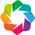

:Image   [x,y]   (water surface elevation above geoid)

In [ ]:
hv.extension('bokeh', 'matplotlib')
plot = ds_raster['wse'].hvplot.image(y='y', x='x')
hv.output(plot)



#### Masquer une variable selon son indicateur de qualité
Exemple pour une donnée L2_HR_Raster, indicateur "wse_qual":\
0 = bonne\
1 = suspecte -  peut comporter des erreurs importantes\
2 = dégradée - susceptible de contenir des erreurs importantes\
3 = mauvaise - peut ne pas faire de sens et doit être ignorée

In [ ]:
variable_to_mask = ds_raster['wse']
mask_variable = ds_raster['wse_qual']


In [ ]:
# Définir la condition pour masquer les données selon l'indicateur de qualité
mask_condition = mask_variable < 3
masked_variable = variable_to_mask.where(mask_condition)
masked_variable


<xarray.DataArray 'wse' (y: 1593, x: 1594)> Size: 10MB
dask.array<where, shape=(1593, 1594), dtype=float32, chunksize=(797, 797), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 13kB 5.754e+05 5.755e+05 ... 7.346e+05 7.347e+05
  * y        (y) float64 13kB 5.016e+06 5.016e+06 ... 5.175e+06 5.175e+06
Attributes:
    long_name:     water surface elevation above geoid
    grid_mapping:  crs
    units:         m
    quality_flag:  wse_qual
    valid_min:     -1500.0
    valid_max:     15000.0
    comment:       Water surface elevation of the pixel above the geoid and a...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
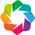

:Image   [x,y]   (water surface elevation above geoid)

In [ ]:
# Mise à jour de la variable masquée dans l'ensemble de données
hv.extension('bokeh', 'matplotlib')
plot2 = masked_variable.hvplot.image(y='y', x='x')
hv.output(plot2)


#### Découpez vos données Raster NetCDF masquées

In [ ]:
# Créez un fichier pour vos données découpées
os.makedirs('./content/clip_data', exist_ok=True)

In [ ]:
#Définir la région d'intérêt
from shapely.geometry import box

ROI = box(-72.73,46.58,-72.60,46.62)
bbox_gdf = gpd.GeoDataFrame({'geometry': [ROI]}, crs='EPSG:4326')


In [ ]:
# Définir les dimensions spatiales du jeu de données et le système de référence des coordonnées (crs).
masked_variable.rio.set_spatial_dims(x_dim="x", y_dim="y", inplace=True)
masked_variable.rio.write_crs("epsg:32618", inplace=True)


<xarray.DataArray 'wse' (y: 1593, x: 1594)> Size: 10MB
dask.array<where, shape=(1593, 1594), dtype=float32, chunksize=(797, 797), chunktype=numpy.ndarray>
Coordinates:
  * x        (x) float64 13kB 5.754e+05 5.755e+05 ... 7.346e+05 7.347e+05
  * y        (y) float64 13kB 5.016e+06 5.016e+06 ... 5.175e+06 5.175e+06
    crs      int64 8B 0
Attributes:
    long_name:     water surface elevation above geoid
    units:         m
    quality_flag:  wse_qual
    valid_min:     -1500.0
    valid_max:     15000.0
    comment:       Water surface elevation of the pixel above the geoid and a...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
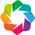

:Image   [x,y]   (water surface elevation above geoid)

In [ ]:
# Découper le raster
# Si nécessaire, reprojetez d'abord la région d'intérêt dans le même EPSG que celui du netCDF
bbox_gdf = bbox_gdf.to_crs("epsg:32618")
clipped = masked_variable.rio.clip(bbox_gdf.geometry.apply(mapping), drop=True)

#Vérification de la zone d'intérêt recadrée
hv.extension('bokeh', 'matplotlib')
plot2 = clipped.hvplot.image(y='y', x='x')
hv.output(plot2)


In [ ]:
# Supprimez l'attribut 'grid_mapping'
if 'grid_mapping' in clipped.attrs:
    del clipped.attrs['grid_mapping']

# Sauvegardez le raster découpé en un fichier NetCDF
clipped_path = './content/clip_data/clipped_raster.nc'  # Définir le chemin et le nom du fichier à sauvegarder
clipped.to_netcdf(clipped_path)

#### **6. Transformation des systèmes de références**





Le système de référence de SWOT n'est pas le même que celui du Canada. Il est donc nécessaire de convertir les données.
**Attention : Chaque agence géodésique provinciale canadienne peut adopter un système de référence vertical et une époque différents !**


Découper les données avec le masque du Québec (nécessaire car chaque province peut adopter une époque et un système de référence vertical différents).

Attention : changez le nom du fichier RiverSp pour qu'il corresponde à celui que vous voulez.


In [ ]:
import os
os.makedirs('ref_change', exist_ok=True)

# Téléchargez le fichier GeoJSON avec les provinces
url = 'https://data.opendatasoft.com/api/explore/v2.1/catalog/datasets/georef-canada-province@public/exports/geojson?lang=fr&timezone=America%2FNew_York'

gdf_prov = gpd.read_file(url)

# Filtrez le GeoDataFrame pour sélectionner seulement celui de la province de Québec
quebec_gdf = gdf_prov[gdf_prov['prov_name_fr'] == 'Québec']

print(quebec_gdf.geometry)


0    MULTIPOLYGON (((-73.86407 45.51852, -73.94004 ...
Name: geometry, dtype: geometry


In [ ]:
#  Téléchargez le shapefile à découper et vérifiez que le masque et le fichier RiverSp on le même système de coordonnées
from shapely.ops import unary_union

logging.getLogger('fiona').setLevel(logging.ERROR)

shapefile_path = '/content/data_downloads/SWOT_L2_HR_RiverSP_Node_005_576_NA_20231102T054530_20231102T054541_PGC0_01.shp'

points_gdf = gpd.read_file(shapefile_path)

quebec_gdf = quebec_gdf.to_crs(points_gdf.crs)

points_gdf_masked = points_gdf.clip(mask= quebec_gdf.geometry)

# Sauvergardez les noeuds selectionnés en format shapefile
points_gdf_masked.to_file('/content/ref_change/qc_nodes.shp')



Affichage des données découpées

In [ ]:
# Affichage rapide
fig, ax = plt.subplots(figsize=(7,5))
points_gdf_masked.plot(ax=ax, color='black')
quebec_gdf.boundary.plot(ax=ax, edgecolor='red')
cx.add_basemap(ax, crs=points_gdf_masked.crs, source=cx.providers.Esri.WorldStreetMap)
plt.show()

#Sauvegardez votre image
plt.savefig('/content/clippeddata.png')

Ensuite, les données doivent être extraites et sauvegardées dans le bon format pour être utilisées avec l'outil TRX de RNCan.

In [ ]:
# Entrez le chemin de vos données
data_all = []

with shapefile.Reader('/content/ref_change/qc_nodes.shp') as shp:

    fields = [field[0] for field in shp.fields if field[0] != 'DeletionFlag']

    for record in shp.records():
          attributs = dict(zip(fields, record))
          #Selectionnez le node_id, la latitude, la longitude et les wse qui ne sont pas -999999999999
          if all(value != -999999999999 for value in attributs.values()):
            data_all.append([attributs['node_id'],attributs['lat'],attributs['lon'],attributs['wse']])

header = ['Station','latitude','longitude','height']

# Création et écriture d'une fichier CSV
with open('/content/ref_change/wse_qc.csv', 'w', newline='', encoding='utf-8') as fichier:
    writer = csv.writer(fichier)
    writer.writerow(header)

    # Écriture des données
    for data in data_all:
        writer.writerow(data)

#Sauvergarde dans les fichiers
from google.colab import files
files.download("/content/ref_change/wse_qc.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Enfin, pour utiliser TRX en ligne, rendez-vous sur le site web : https://webapp.csrs-scrs.nrcan-rncan.gc.ca/geod/tools-outils/trx.php?locale=fr


Remplissez cette information dans la fenêtre **Traitement par lots** :

**Origine** :  Cadre de référence : ITRF2014 epoque 01/01/2010

**Destination** : Cadre de référence : NAD83(CSRS) Coordinates : Geographic

 **Transformation d'époque** : 01/01/1997 (époque adoptée pour le Québec, adaptez l'époque en conséquence)

Sélectionnez le fichier téléchargé précédemment.

#### **7. Téléchargez toutes vos données SWOT sur votre machine locale d'un coup**






Vous pouvez télécharger les données une par une en cliquant sur les trois petits points à droite du nom du fichier et ensuite sur « Télécharger ». Pour télécharger toutes les données d'un coup, exécutez les cellules suivantes. Les temps d'exécution et de téléchargement peuvent être longs.

In [ ]:
# Créez un fichier zip avec toutes les données et choisissez le fichier à compresser
!zip -r /content/data.zip /content/data_downloads

  adding: content/data_downloads/ (stored 0%)
  adding: content/data_downloads/SWOT_L2_HR_RiverSP_Node_005_576_NA_20231102T054530_20231102T054541_PGC0_01.shx (deflated 71%)
  adding: content/data_downloads/SWOT_L2_HR_RiverSP_Node_005_576_NA_20231102T054530_20231102T054541_PGC0_01.shp.xml (deflated 85%)
  adding: content/data_downloads/SWOT_L2_HR_RiverSP_Node_005_576_NA_20231102T054530_20231102T054541_PGC0_01.zip (stored 0%)
  adding: content/data_downloads/SWOT_L2_HR_Raster_100m_UTM18T_N_x_x_x_003_576_037F_20230921T121803_20230921T121824_PGC0_01.nc


zip error: Interrupted (aborting)


In [ ]:
# Téléchargez le fichier compressé
from google.colab import files
files.download("/content/data.zip")


FileNotFoundError: Cannot find file: /content/data.zip

#### **8. Travailler avec HYDROCON**


Extraire des séries temporelles avec Hydrocon pour les Reach et Nodes d'intérêt

In [ ]:
from ast import And
import folium
import requests
from io import StringIO
import pandas as pd
import matplotlib.pyplot as plt

# Vous pouvez choisir un identifiant de Node ou de Reach à partir du produit RiverSP obtenu dans la section 1.
#Exemple pour la rivière Saint-Maurice

#feature='Node'
#feature_id="71250300150401"
feature="Reach"
feature_id="72520100041"
#start_time="2023-08-01T00:00:00Z"
#end_time="2024-08-01T00:00:00Z"
#fields=reach_id,time_str,wse,width

parameters = "https://soto.podaac.earthdatacloud.nasa.gov/hydrocron/v1/timeseries?feature="+feature+"&feature_id="+ feature_id +"&start_time=2024-01-01T00:00:00Z&end_time=2024-06-06T00:00:00Z&output=geojson&fields=reach_id,time_str,wse,width,cycle_id"


hydrocron_response = requests.get(
    parameters
).json()

hydrocron_response

# Extraction du geojson pour l'afficher sur la carte

geojson_data = hydrocron_response['results']['geojson']

geojson_data

# Configurez la carte à l'aide de Folium (https://python-visualization.github.io/folium/latest/)

map = folium.Map (zoom_start=13, tiles="cartodbpositron", width=700, height=700)

# Ajoutez le geojson provenant d'Hydrocron à la carte
folium.GeoJson(geojson_data, name='SWOT River Reach').add_to(map)
folium.LayerControl().add_to(map)

# Centrez sur la rivière
map.fit_bounds(map.get_bounds(), padding=(5, 5))

map


Afficher une série temporelle de niveau d'eau pour un noeud d'intérêt

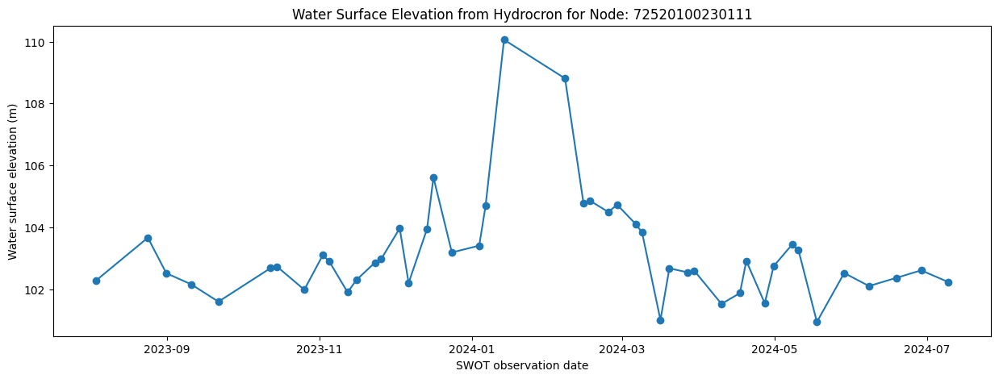

In [ ]:
#Exemple pour la rivière Saint-Maurice

feature='Node'
feature_id="72520100230111" # Rapides-Manigance
start_time="2023-08-01T00:00:00Z"
end_time="2024-08-01T00:00:00Z"
#fields=reach_id,time_str,wse,width

#parameters = "https://soto.podaac.earthdatacloud.nasa.gov/hydrocron/v1/timeseries?feature="+feature+"&feature_id="+ feature_id +"&start_time=2024-01-01T00:00:00Z&end_time=2024-06-14T00:00:00Z&output=csv&fields=reach_id,node_id,time_str,node_q,wse,width,cycle_id"

parameters = "https://soto.podaac.earthdatacloud.nasa.gov/hydrocron/v1/timeseries?feature="+feature+"&feature_id="+ feature_id +"&start_time="+start_time+"&end_time="+end_time+"&output=csv&fields=reach_id,node_id,time_str,node_q,wse,width,cycle_id"



hydrocron_response = requests.get(
    parameters
).json()

hydrocron_response
csv_str = hydrocron_response['results']['csv']
df = pd.read_csv(StringIO(csv_str))
ind = df.node_q<3

df = df[df['time_str'] != 'no_data']
df.time_str = pd.to_datetime(df.time_str, format='%Y-%m-%dT%H:%M:%SZ')
fig = plt.figure(figsize=(15,5))
plt.plot(df.time_str[ind], df.wse[ind], marker='o')

plt.ylabel('Water surface elevation (m)')
plt.xlabel('SWOT observation date')
plt.title('Water Surface Elevation from Hydrocron for Node: ' + str(df.node_id[0]))

#Sauvegardez votre image
plt.savefig('/content/WSE_Hydrocon.png')


#### **9. Extraire un profil entre deux noeuds**

In [ ]:
# Créez un fichier pour vos données
os.makedirs('./content/profil_node', exist_ok=True)

Authentification et téléchargement des données

In [ ]:
# Fonction pour rechercher et télécharger les données
def download_data(pass_numbers, continent_code, path, temporal_range):
    links_list = []
    for pass_num in pass_numbers:
        river_results = earthaccess.search_data(
            short_name='SWOT_L2_HR_RIVERSP_2.0',
            temporal=temporal_range,
            granule_name=f"*Node*_{pass_num}_{continent_code}*"
        )
        links_list.extend([earthaccess.results.DataGranule.data_links(result, access='external')[0]
                           for result in river_results])

    # Téléchargement des fichiers
    earthaccess.download(links_list, path)
    return links_list

Extraction des fichiers ZIP et chargement des shapefiles

In [ ]:
# Fonction pour extraire les fichiers ZIP
def extract_files(links_list, path):
    filenames = [link.split("/")[-1] for link in links_list]
    for filename in filenames:
        with zipfile.ZipFile(f"{path}/{filename}", 'r') as zip_ref:
            zip_ref.extractall(path)
    return filenames

# Fonction pour charger les shapefiles
def load_shapefiles(filenames, path):
    filename_shps = [filename.replace('zip', 'shp') for filename in filenames]
    return gpd.GeoDataFrame(pd.concat([gpd.read_file(f"{path}/{shp}") for shp in filename_shps], ignore_index=True))

Filtrage des noeuds et calcul des distances

In [ ]:
# Fonction pour filtrer les données par noeuds et temps
def filter_data_by_nodes(SWOT_HR_df, up_node, dn_node, date=None):
    filtered = SWOT_HR_df[(SWOT_HR_df['node_id'] >= dn_node) &
                          (SWOT_HR_df['node_id'] < up_node) &
                          (SWOT_HR_df['reach_id'] != '72520100361')] #  pour noeud problématique
    if date:
        filtered = filtered[filtered['time_str'].str.contains(date)]
    return filtered.sort_values(['node_id'])

def calculate_distances(SWOT_HR_profil):
    """
    Calcule la distance cumulée à partir de la colonne 'p_length' de SWOT_HR_profil_1.

    """
    delta = SWOT_HR_profil.p_length
    # Initialiser un tableau de zéros pour stocker les distances cumulées
    dist_1=np.zeros((len(SWOT_HR_profil),1))

    # Calcul des distances cumulées
    for n in range(len(SWOT_HR_profil)-1):
      dist_1[n+1]=dist_1[n]+delta.iloc[n]

    return dist_1

Tracé du profil

In [ ]:
# Fonction pour tracer le profil de hauteur d'eau
def plot_profile(profile, dist, label):
    fig, ax = plt.subplots(figsize=(15, 5))
    ax.plot(dist, profile['wse'], marker='o', linestyle='None', label=label)
    ax.set_xlabel('Distance cumulative (m)')
    ax.set_ylabel('Hauteur d\'eau (wse)')
    ax.legend()
    plt.show()
    #Sauvegardez votre image
    plt.savefig('/content/profil.png')

Variables à modifier selon les besoins

In [ ]:
# Chemin du répertoire où les données seront enregistrées et variables à identifier
path = '/content/profil_node'
pass_number    = ["063"]  # Liste de numéros de passage (063, 270, 576, 369)
continent_code = "NA"  # Code du continent (NA pour Amérique du Nord)
temporal_range = '2024-04-04 00:00:00', '2024-08-01 23:59:59'
dn_node = 72520100020381  # ID du noeud en aval
up_node = 72520100020561  # ID du noeud en amont

Exécution complète

QUEUEING TASKS | :   0%|          | 0/5 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/5 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/5 [00:00<?, ?it/s]

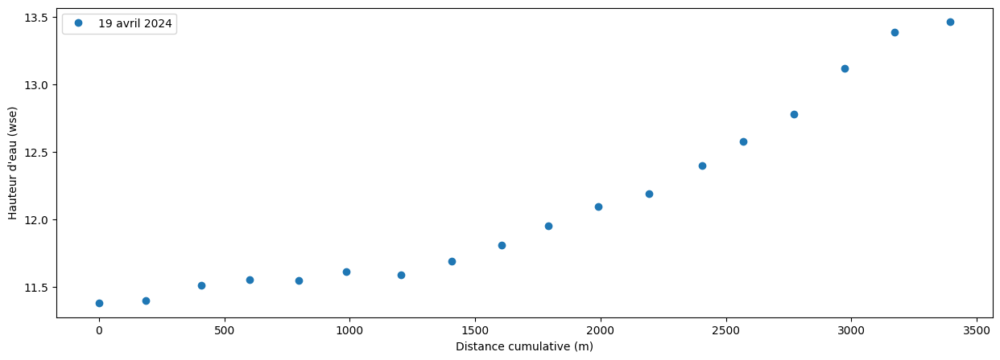

<Figure size 640x480 with 0 Axes>

In [ ]:
# Téléchargement des données
links_list = download_data(pass_number, continent_code, path, temporal_range)
filenames = extract_files(links_list, path)

# Chargement des shapefiles
SWOT_HR_df = load_shapefiles(filenames, path)
SWOT_HR_df['node_id'] = SWOT_HR_df['node_id'].astype(float)


# Filtrage du profil pour la date du 19 avril 2024
profile_1 = filter_data_by_nodes(SWOT_HR_df, up_node, dn_node, date='2024-04-19')

# Calcul des distances cumulées
dist_1 = calculate_distances(profile_1)

# Tracé du profil
plot_profile(profile_1, dist_1, '19 avril 2024')